In [2]:
#Import Libraries
import pandas as pd
%matplotlib inline
from MCForecastTools import MCSimulation
import warnings
warnings.filterwarnings('ignore')
from pathlib import Path
import plotly.express as px
import numpy as np

Bit Coin (BTC)

Ethereum (ETH)

Dogecoin (DOGE)

Litecoin (LTC)

In [3]:
# Reading in the Pre-Covid time frame csv files
btc_pre = pd.read_csv(Path('./Resources/BTC_PRECOVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
doge_pre = pd.read_csv(Path('./Resources/DOGE_PRECOVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
eth_pre = pd.read_csv(Path('./Resources/ETH_PRECOVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
ltc_pre = pd.read_csv(Path('./Resources/LTC_PRECOVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)

In [4]:
# Reading in the Covid time frame csv files
btc_covid = pd.read_csv(Path('./Resources/BTC_COVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
doge_covid = pd.read_csv(Path('./Resources/DOGE_COVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
eth_covid = pd.read_csv(Path('./Resources/ETH_COVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
ltc_covid = pd.read_csv(Path('./Resources/LTC_COVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)

In [5]:
# Reading in the Post-Covid time frame csv files
btc_post = pd.read_csv(Path('./Resources/BTC_POST.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
doge_post = pd.read_csv(Path('./Resources/DOGE_POST.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
eth_post = pd.read_csv(Path('./Resources/ETH_POST.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
ltc_post = pd.read_csv(Path('./Resources/LTC_POST.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)

In [7]:
# Concatenating the Pre-Covid time frame data frames
crypto_pre = pd.concat([btc_pre, doge_pre, eth_pre, ltc_pre], axis=1, join='inner')
crypto_pre.columns = ['BTC', 'DOGE', 'ETH', 'LTC']
print(crypto_pre.isnull().sum())
crypto_pre

BTC     0
DOGE    0
ETH     0
LTC     0
dtype: int64


,BTC,DOGE,ETH,LTC
Date,,,,
11/9/2017,7143.580078,0.001415,320.884003,64.269699
11/10/2017,6618.140137,0.001163,299.252991,59.260101
11/11/2017,6357.600098,0.001201,314.681000,62.303299
11/12/2017,5950.069824,0.001038,307.907990,59.005402
11/13/2017,6559.490234,0.001211,316.716003,61.396500
...,...,...,...,...
12/27/2019,7290.088379,0.002053,127.214607,41.178173
12/28/2019,7317.990234,0.002064,128.322708,42.842522
12/29/2019,7422.652832,0.002068,134.757980,43.670658


In [6]:
# Finding the index for minumum and maximum value of all cryptos
pre_high_date = crypto_pre.idxmax()
pre_low_date = crypto_pre.idxmin()
btc_pre_high_date = pre_high_date[0]
btc_pre_low_date = pre_low_date[0]
doge_pre_high_date = pre_high_date[1]
doge_pre_low_date = pre_low_date[1]
eth_pre_high_date = pre_high_date[2]
eth_pre_low_date = pre_low_date[2]
ltc_pre_high_date = pre_high_date[3]
ltc_pre_low_date = pre_low_date[3]

# Finding the minimum and maximum value for all cryptos
pre_high_value =  crypto_pre.max()
pre_low_value = crypto_pre.min()
btc_pre_high = round(pre_high_value[0],2)
btc_pre_low = round(pre_low_value[0],2)
doge_pre_high = pre_high_value[1]
doge_pre_low = pre_low_value[1]
eth_pre_high = round(pre_high_value[2],2)
eth_pre_low = round(pre_low_value[2],2)
ltc_pre_high = round(pre_high_value[3],2)
ltc_pre_low = round(pre_low_value[3],2)

# Printing the results
print('Pre-Covid Highs/Lows''\n'
     '-----------------------''\n'
f'Bitcoin High of ${btc_pre_high} on {btc_pre_high_date} | Bitcoin Low of ${btc_pre_low} on {btc_pre_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Dogecoin High of ${doge_pre_high} on {doge_pre_high_date} | Dogecoin Low of ${doge_pre_low} on {doge_pre_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Ethereum High of ${eth_pre_high} on {eth_pre_high_date} | Ethereum Low of ${eth_pre_low} on {eth_pre_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Litecoin High of ${ltc_pre_high} on {ltc_pre_high_date} | Litecoin Low of ${ltc_pre_low} on {ltc_pre_low_date}''\n'
     '________________________________________________________________________________')



Pre-Covid Highs/Lows
-----------------------
Bitcoin High of $19497.4 on 12/16/2017 | Bitcoin Low of $3236.76 on 12/15/2018
________________________________________________________________________________

Dogecoin High of $0.017088 on 1/7/2018 | Dogecoin Low of $0.001038 on 11/12/2017
________________________________________________________________________________

Ethereum High of $1396.42 on 1/13/2018 | Ethereum Low of $84.31 on 12/14/2018
________________________________________________________________________________

Litecoin High of $358.34 on 12/18/2017 | Litecoin Low of $23.46 on 12/14/2018
________________________________________________________________________________


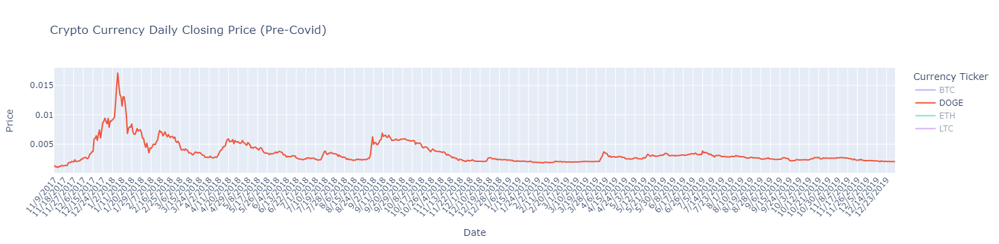

In [43]:
# Plotting daily prices from Pre-Covid time frame
crypto_pre_plot = px.line(crypto_pre, title='Crypto Currency Daily Closing Price (Pre-Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Price').update_xaxes(tickangle=310)
crypto_pre_plot

In [8]:
# Calculating Daily Return for all crypto currencies
crypto_pre_change = crypto_pre.pct_change().dropna()
crypto_pre_change.head()

,BTC,DOGE,ETH,LTC
Date,,,,
11/10/2017,-0.073554,-0.178092,-0.067411,-0.077946
11/11/2017,-0.039368,0.032674,0.051555,0.051353
11/12/2017,-0.064101,-0.135720,-0.021523,-0.052933
11/13/2017,0.102422,0.166667,0.028606,0.040523
11/14/2017,0.011626,-0.022296,0.066037,0.020899


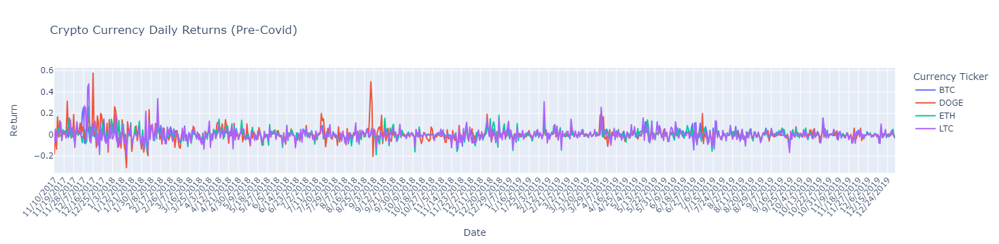

In [9]:
# Plotting the daily return
crypto_pre_ret_plot = px.line(crypto_pre_change, title='Crypto Currency Daily Returns (Pre-Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Return').update_xaxes(tickangle=310)
crypto_pre_ret_plot

In [10]:
# Calculating the cumulative daily return
crypto_pre_cum_ret = (1+crypto_pre_change).cumprod() -1
crypto_pre_cum_ret.tail()

,BTC,DOGE,ETH,LTC
Date,,,,
12/27/2019,0.020509,0.450883,-0.603550,-0.359291
12/28/2019,0.024415,0.458657,-0.600096,-0.333395
12/29/2019,0.039066,0.461484,-0.580041,-0.320509
12/30/2019,0.020916,0.451590,-0.586662,-0.334876
12/31/2019,0.007002,0.433216,-0.596082,-0.356772


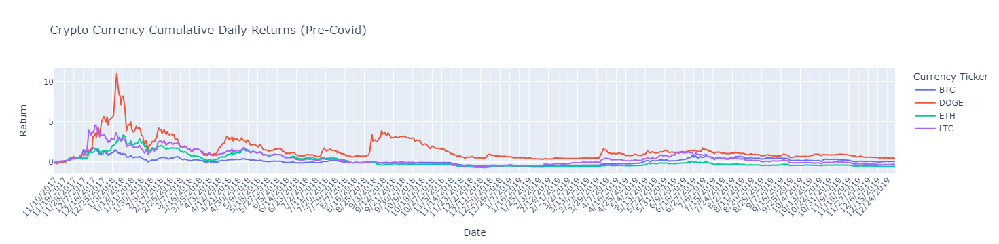

In [11]:
# Plotting the cumulative daily return
crypto_pre_cum_ret_plot = px.line(crypto_pre_cum_ret, title='Crypto Currency Cumulative Daily Returns (Pre-Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Return').update_xaxes(tickangle=310)
crypto_pre_cum_ret_plot

In [12]:
# Calculating the standard deviation
crypto_pre_std = crypto_pre_change.std()*np.sqrt(252)
crypto_pre_std

BTC     0.675194
DOGE    1.027625
ETH     0.806472
LTC     0.945852
dtype: float64

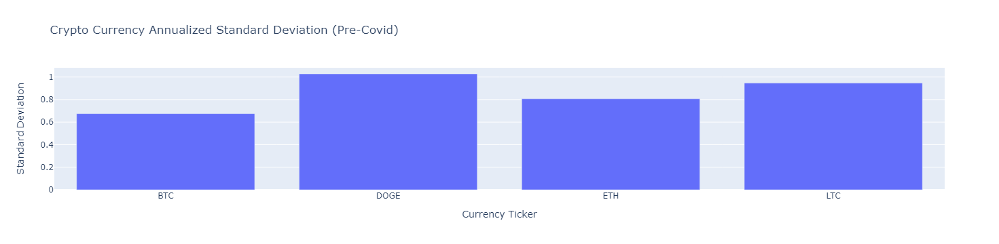

In [13]:
# Plotting the standard deviation
crypto_pre_std_plot = px.bar(crypto_pre_std, title = 'Crypto Currency Annualized Standard Deviation (Pre-Covid)').update_layout(showlegend = False, xaxis_title = 'Currency Ticker', yaxis_title = 'Standard Deviation')
crypto_pre_std_plot

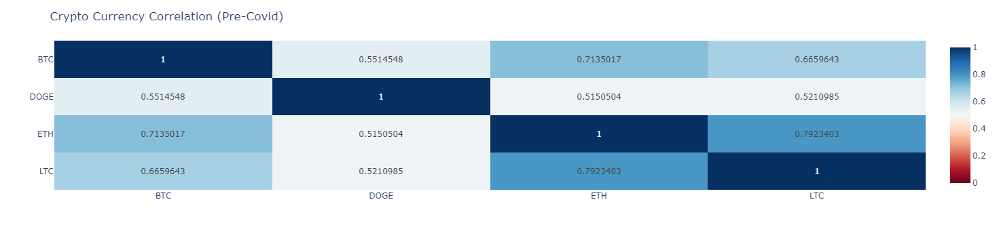

In [14]:
crypto_pre_corr = crypto_pre_change.corr()
crypto_pre_corr_plot = px.imshow(crypto_pre_corr, text_auto=True, aspect='auto', color_continuous_scale='RdBu', range_color=[0,1]).update_yaxes(side='left').update_layout(title_text='Crypto Currency Correlation (Pre-Covid)')
crypto_pre_corr_plot

In [15]:
# Concatenating the Covid time frame data frames
crypto_covid = pd.concat([btc_covid, doge_covid, eth_covid, ltc_covid], axis=1,join='inner', keys = ["BTC", "DOGE", "ETH", "LTC"])
crypto_covid.columns = ["BTC", "DOGE", "ETH", "LTC"]
print(crypto_covid.isnull().sum())
crypto_covid.head()

BTC     0
DOGE    0
ETH     0
LTC     0
dtype: int64


,BTC,DOGE,ETH,LTC
Date,,,,
1/1/2020,7200.174316,0.002033,130.802002,42.017719
1/2/2020,6985.470215,0.002009,127.410179,39.823013
1/3/2020,7344.884277,0.002145,134.171707,42.415573
1/4/2020,7410.656738,0.002241,135.069366,43.326607
1/5/2020,7411.317383,0.002419,136.276779,43.553207


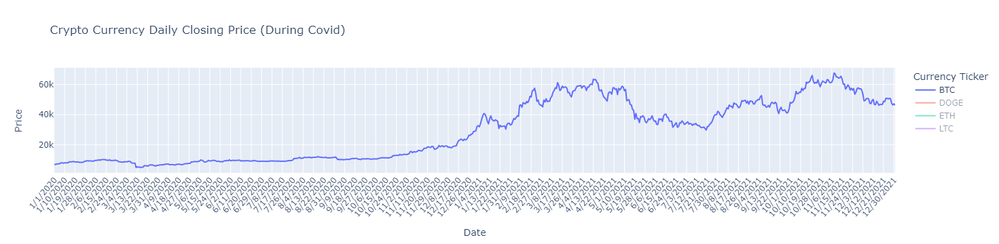

In [16]:
crypto_covid_plot = px.line(crypto_covid, title='Crypto Currency Daily Closing Price (During Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Price').update_xaxes(tickangle=310)
crypto_covid_plot

In [17]:
# Finding the index for minumum and maximum value of all cryptos
cov_high_date = crypto_covid.idxmax()
cov_low_date = crypto_covid.idxmin()
btc_cov_high_date = cov_high_date[0]
btc_cov_low_date = cov_low_date[0]
doge_cov_high_date = cov_high_date[1]
doge_cov_low_date = cov_low_date[1]
eth_cov_high_date = cov_high_date[2]
eth_cov_low_date = cov_low_date[2]
ltc_cov_high_date = cov_high_date[3]
ltc_cov_low_date = cov_low_date[3]

# Finding the minimum and maximum value for all cryptos
cov_high_value =  crypto_covid.max()
cov_low_value = crypto_covid.min()
btc_cov_high = round(cov_high_value[0],2)
btc_cov_low = round(cov_low_value[0],2)
doge_cov_high = cov_high_value[1]
doge_cov_low = cov_low_value[1]
eth_cov_high = round(cov_high_value[2],2)
eth_cov_low = round(cov_low_value[2],2)
ltc_cov_high = round(cov_high_value[3],2)
ltc_cov_low = round(cov_low_value[3],2)



# Printing the results
print('Covid Highs/Lows''\n'
     '-----------------------''\n'
f'Bitcoin High of ${btc_cov_high} on {btc_cov_high_date} | Bitcoin Low of ${btc_cov_low} on {btc_cov_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Dogecoin High of ${doge_cov_high} on {doge_cov_high_date} | Dogecoin Low of ${doge_cov_low} on {doge_cov_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Ethereum High of ${eth_cov_high} on {eth_cov_high_date} | Ethereum Low of ${eth_cov_low} on {eth_cov_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Litecoin High of ${ltc_cov_high} on {ltc_cov_high_date} | Litecoin Low of ${ltc_cov_low} on {ltc_cov_low_date}''\n'
     '________________________________________________________________________________')

Covid Highs/Lows
-----------------------
Bitcoin High of $67566.83 on 11/8/2021 | Bitcoin Low of $4970.79 on 3/12/2020
________________________________________________________________________________

Dogecoin High of $0.684777 on 5/7/2021 | Dogecoin Low of $0.001537 on 3/12/2020
________________________________________________________________________________

Ethereum High of $4812.09 on 11/8/2021 | Ethereum Low of $110.61 on 3/16/2020
________________________________________________________________________________

Litecoin High of $386.45 on 5/9/2021 | Litecoin Low of $30.93 on 3/12/2020
________________________________________________________________________________


In [18]:
# Calculating the daily return
crypto_covid_change = crypto_covid.pct_change().dropna()
crypto_covid_change.head(5)

,BTC,DOGE,ETH,LTC
Date,,,,
1/2/2020,-0.029819,-0.011805,-0.025931,-0.052233
1/3/2020,0.051452,0.067695,0.053069,0.065102
1/4/2020,0.008955,0.044755,0.006690,0.021479
1/5/2020,0.000089,0.079429,0.008939,0.005230
1/6/2020,0.048291,0.018189,0.058905,0.051963


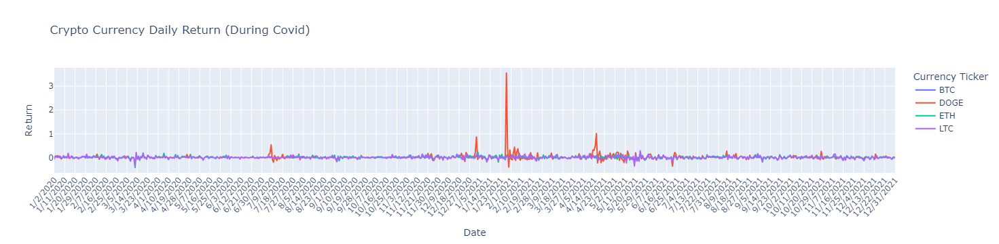

In [19]:
# Plotting the daily return
crypto_covid_ret_plot = px.line(crypto_covid_change, labels = 'Crypto Name', title = 'Crypto Currency Daily Return (During Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Return').update_xaxes(tickangle=310)
crypto_covid_ret_plot

In [20]:
# Calculating the cumulative return
crypto_covid_cum_ret = (1+crypto_covid_change).cumprod() -1
crypto_covid_cum_ret.tail()

,BTC,DOGE,ETH,LTC
Date,,,,
12/27/2021,6.033221,91.329070,29.867629,2.709893
12/28/2021,5.609403,84.645352,28.058371,2.472032
12/29/2021,5.450498,81.520905,26.740644,2.463125
12/30/2021,5.552359,83.266109,27.392930,2.529130
12/31/2021,5.431295,82.864240,27.154254,2.486975


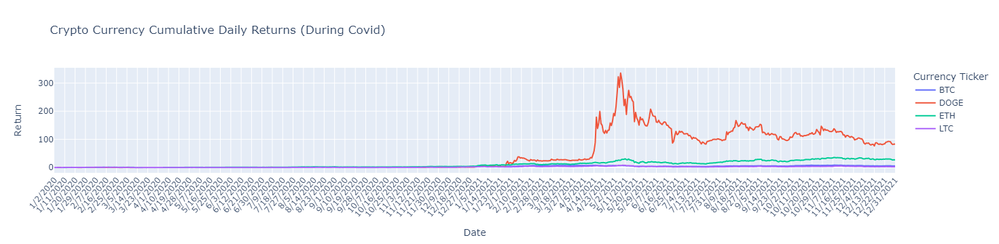

In [21]:
# Plotting the cumulative return
crypto_covid_cum_ret_plot = px.line(crypto_covid_cum_ret, title='Crypto Currency Cumulative Daily Returns (During Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Return').update_xaxes(tickangle=310)
crypto_covid_cum_ret_plot

In [22]:
# Calculating the standard deviation
crypto_covid_std = crypto_covid_change.std()*np.sqrt(252)
crypto_covid_std

BTC     0.634576
DOGE    2.549712
ETH     0.838042
LTC     0.892995
dtype: float64

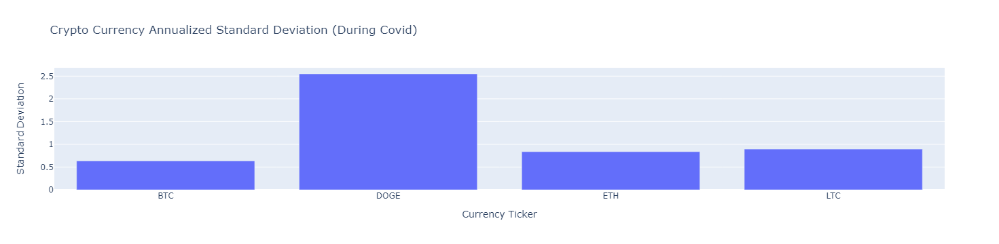

In [23]:
# Plotting the standard deviation
crypto_covid_std_plot = px.bar(crypto_covid_std, title = 'Crypto Currency Annualized Standard Deviation (During Covid)')
crypto_covid_std_plot.update_layout(showlegend = False, xaxis_title = 'Currency Ticker', yaxis_title = 'Standard Deviation')

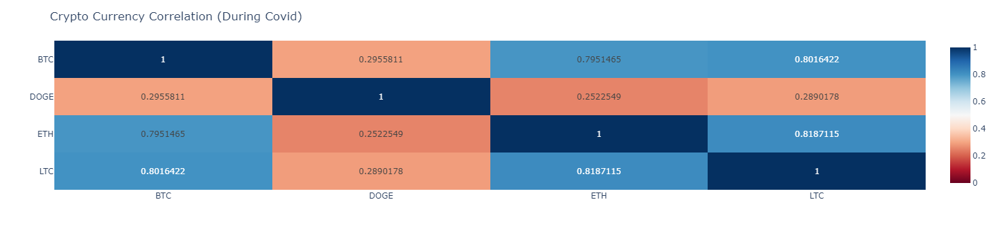

In [24]:
crypto_covid_corr = crypto_covid_change.corr()
crypto_covid_corr_plot = px.imshow(crypto_covid_corr, text_auto=True, aspect='auto', color_continuous_scale='RdBu', range_color=[0,1]).update_yaxes(side='left').update_layout(title_text='Crypto Currency Correlation (During Covid)')
crypto_covid_corr_plot

In [25]:
btc_post.rename(columns=str.lower, inplace=True)
doge_post.rename(columns=str.lower, inplace=True)
eth_post.rename(columns=str.lower, inplace=True)
ltc_post.rename(columns=str.lower, inplace=True)

In [26]:
#Concatenating the Post-Covid time frame data frames
crypto_post = pd.concat([btc_post, doge_post, eth_post, ltc_post], axis=1,join='inner')
crypto_post.columns = ["BTC", "DOGE", "ETH", "LTC"]
print(crypto_post.isnull().sum())
crypto_post.head()

BTC     0
DOGE    0
ETH     0
LTC     0
dtype: int64


,BTC,DOGE,ETH,LTC
Date,,,,
1/1/2022,47686.81250,0.173035,3769.697021,150.697433
1/2/2022,47345.21875,0.174403,3829.564941,151.255493
1/3/2022,46458.11719,0.170088,3761.380371,148.461594
1/4/2022,45897.57422,0.168803,3794.056641,146.812286
1/5/2022,43569.00391,0.159420,3550.386963,136.089111


In [27]:
#Concatenating the Post-Covid time frame data frames
crypto_post_keyed = pd.concat([btc_post, doge_post, eth_post, ltc_post], axis=1,join='inner', keys = ["BTC", "DOGE", "ETH", "LTC"])
print(crypto_post.isnull().sum())
crypto_post_keyed.head()

BTC     0
DOGE    0
ETH     0
LTC     0
dtype: int64


,BTC,DOGE,ETH,LTC
,close,close,close,close
Date,,,,
1/1/2022,47686.81250,0.173035,3769.697021,150.697433
1/2/2022,47345.21875,0.174403,3829.564941,151.255493
1/3/2022,46458.11719,0.170088,3761.380371,148.461594
1/4/2022,45897.57422,0.168803,3794.056641,146.812286
1/5/2022,43569.00391,0.159420,3550.386963,136.089111


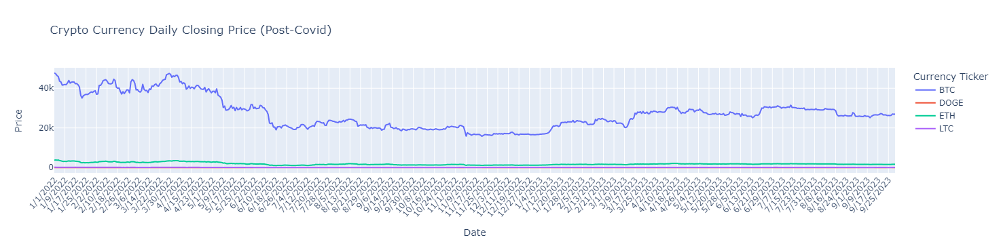

In [28]:
crypto_post_plot = px.line(crypto_post, title='Crypto Currency Daily Closing Price (Post-Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Price').update_xaxes(tickangle=310)
crypto_post_plot

In [29]:
# Finding the index for minumum and maximum value of all cryptos
post_high_date = crypto_post.idxmax()
post_low_date = crypto_post.idxmin()
btc_post_high_date = post_high_date[0]
btc_post_low_date = post_low_date[0]
doge_post_high_date = post_high_date[1]
doge_post_low_date = post_low_date[1]
eth_post_high_date = post_high_date[2]
eth_post_low_date = post_low_date[2]
ltc_post_high_date = post_high_date[3]
ltc_post_low_date = post_low_date[3]

# Finding the minimum and maximum value for all cryptos
post_high_value =  crypto_post.max()
post_low_value = crypto_post.min()
btc_post_high = round(post_high_value[0],2)
btc_post_low = round(post_low_value[0],2)
doge_post_high = post_high_value[1]
doge_post_low = post_low_value[1]
eth_post_high = round(post_high_value[2],2)
eth_post_low = round(post_low_value[2],2)
ltc_post_high = round(post_high_value[3],2)
ltc_post_low = round(post_low_value[3],2)

# Printing the results
print('Post-Covid Highs/Lows''\n'
     '-----------------------''\n'
f'Bitcoin High of ${btc_post_high} on {btc_post_high_date} | Bitcoin Low of ${btc_post_low} on {btc_post_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Dogecoin High of ${doge_post_high} on {doge_post_high_date} | Dogecoin Low of ${doge_post_low} on {doge_post_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Ethereum High of ${eth_post_high} on {eth_post_high_date} | Ethereum Low of ${eth_post_low} on {eth_post_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Litecoin High of ${ltc_post_high} on {ltc_post_high_date} | Litecoin Low of ${ltc_post_low} on {ltc_post_low_date}''\n'
     '________________________________________________________________________________')


Post-Covid Highs/Lows
-----------------------
Bitcoin High of $47686.81 on 1/1/2022 | Bitcoin Low of $15787.28 on 11/21/2022
________________________________________________________________________________

Dogecoin High of $0.185103 on 1/15/2022 | Dogecoin Low of $0.053012 on 6/18/2022
________________________________________________________________________________

Ethereum High of $3829.56 on 1/2/2022 | Ethereum Low of $993.64 on 6/18/2022
________________________________________________________________________________

Litecoin High of $151.67 on 1/17/2022 | Litecoin Low of $43.3 on 6/13/2022
________________________________________________________________________________


In [30]:
crypto_post_change = crypto_post.pct_change().dropna()
crypto_post_change.head(5)

,BTC,DOGE,ETH,LTC
Date,,,,
1/2/2022,-0.007163,0.007906,0.015881,0.003703
1/3/2022,-0.018737,-0.024742,-0.017805,-0.018471
1/4/2022,-0.012066,-0.007555,0.008687,-0.011109
1/5/2022,-0.050734,-0.055586,-0.064224,-0.073040
1/6/2022,-0.009366,0.004974,-0.037173,0.003047


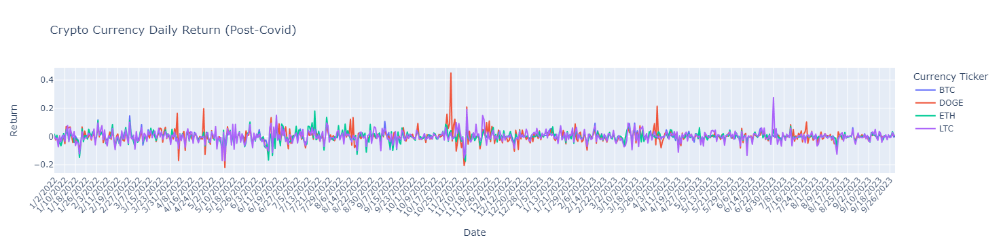

In [31]:
crypto_post_ret_plot = px.line(crypto_post_change, labels = 'Crypto Name', title = 'Crypto Currency Daily Return (Post-Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Return').update_xaxes(tickangle=310)
crypto_post_ret_plot

In [32]:
# Calculating the cumulative return
crypto_post_cum_ret = (1+crypto_post_change).cumprod() -1
crypto_post_cum_ret.tail()

,BTC,DOGE,ETH,LTC
Date,,,,
9/26/2023,-0.450220,-0.649788,-0.577309,-0.576910
9/27/2023,-0.447379,-0.650337,-0.576228,-0.578713
9/28/2023,-0.433354,-0.644673,-0.561534,-0.567087
9/29/2023,-0.435657,-0.640662,-0.557539,-0.564478
9/30/2023,-0.434479,-0.640876,-0.556685,-0.561574


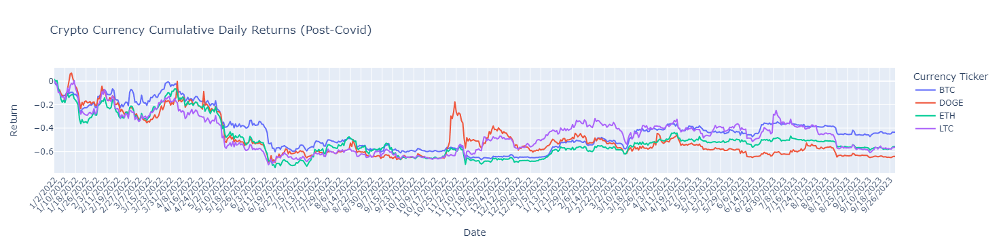

In [33]:
# Plotting the cumulative return
crypto_post_cum_ret_plot = px.line(crypto_post_cum_ret, title='Crypto Currency Cumulative Daily Returns (Post-Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Return').update_xaxes(tickangle=310)
crypto_post_cum_ret_plot

In [34]:
# Calculating the standard deviation
crypto_post_std = crypto_post_change.std()*np.sqrt(252)
crypto_post_std

BTC     0.465496
DOGE    0.756983
ETH     0.597212
LTC     0.664195
dtype: float64

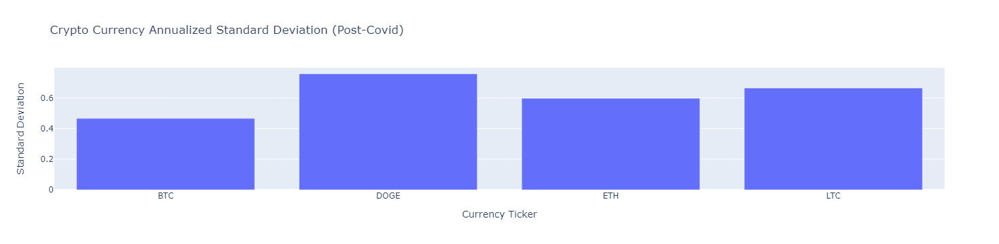

In [35]:
# Plotting the standard deviation 
crypto_post_std_plot = px.bar(crypto_post_std, title = 'Crypto Currency Annualized Standard Deviation (Post-Covid)')
crypto_post_std_plot.update_layout(showlegend = False, xaxis_title = 'Currency Ticker', yaxis_title = 'Standard Deviation')

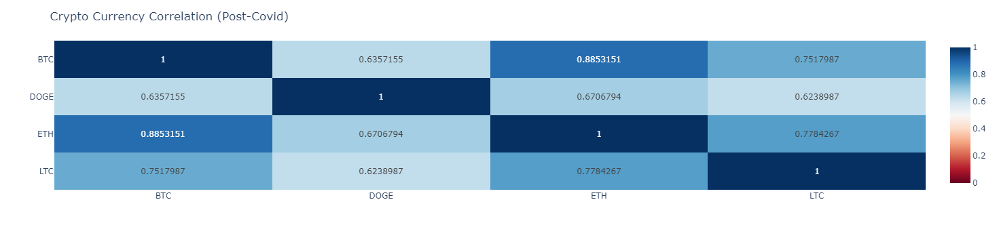

In [36]:
crypto_post_corr = crypto_post_change.corr()
crypto_post_corr_plot = px.imshow(crypto_post_corr, text_auto=True, aspect='auto', color_continuous_scale='RdBu', range_color=[0,1]).update_yaxes(side='left').update_layout(title_text='Crypto Currency Correlation (Post-Covid)')
crypto_post_corr_plot

In [37]:
# Setting the varaibles to be used in the simulation
num_sims = 100
trading_days = 252*10

In [38]:
# Setting the parameters for the monte carlo simulation
MC_POST = MCSimulation(
    portfolio_data = crypto_post_keyed,
    num_simulation = num_sims,
    num_trading_days = trading_days
)

In [39]:
# Running the cumulative return simulation
MC_cum_ret = MC_POST.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.


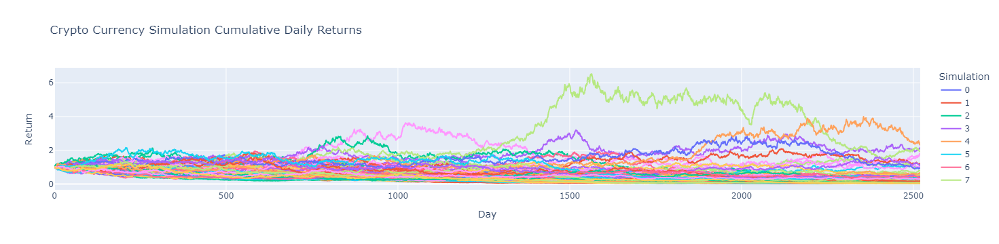

In [40]:
MC_plot = px.line(MC_cum_ret, title='Crypto Currency Simulation Cumulative Daily Returns').update_layout(legend_title_text = 'Simulation', yaxis_title = 'Return', xaxis_title = 'Day')
MC_plot

In [41]:
# Getting the summary of the monte carlo simulation
sim_stats_10y = MC_POST.summarize_cumulative_return()
print(sim_stats_10y)

count           100.000000
mean              0.340333
std               0.462019
min               0.022902
25%               0.076277
50%               0.170168
75%               0.362813
max               2.315771
95% CI Lower      0.027964
95% CI Upper      1.870111
Name: 2520, dtype: float64


In [42]:
# Set initial investment 
# Including an input statement to give more options in initial investment. 
initial_investment_10y = int(input('What would you like your initial investment to be?(Please use whole numbers.)'))
# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our initial investment
ci_lower_10y = round(sim_stats_10y[8]*initial_investment_10y,2)
ci_upper_10y = round(sim_stats_10y[9]*initial_investment_10y,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment_10y} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_10y} and ${ci_upper_10y}")

What would you like your initial investment to be?(Please use whole numbers.) 10000


There is a 95% chance that an initial investment of $10000 in the portfolio over the next 10 years will end within in the range of $279.64 and $18701.11
